In [1]:
TRAIN =  '/kaggle/input/fungi-multiclass-microscopic-fungi-images/fungi-classification-microscopic-images/train'
TEST =  '/kaggle/input/fungi-multiclass-microscopic-fungi-images/fungi-classification-microscopic-images/test'
VAL =  '/kaggle/input/fungi-multiclass-microscopic-fungi-images/fungi-classification-microscopic-images/valid'

We want to use image embeddings for EDA and classification, so let's introduce some code to get image embeddings using ResNeXt without fine-tuning.

In [2]:
import torch
import torchvision.models as models
import torchvision.transforms as transforms
import numpy as np


DEVICE = torch.device('cpu')
OUTPUT_SIZE = 2048

model = models.resnext50_32x4d(weights=models.ResNeXt50_32X4D_Weights.IMAGENET1K_V2)

extraction_layer = model._modules.get('avgpool')
model.to(DEVICE)
model.eval()

scaler = transforms.Resize((224, 224))
normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
to_tensor = transforms.ToTensor()

def get_vec(arg, model, extraction_layer):
    image = normalize(to_tensor(scaler(arg))).unsqueeze(0).to(DEVICE)
    result = torch.zeros(1, OUTPUT_SIZE, 1, 1)
    def copy_data(m, i, o):
        result.copy_(o.data)
    hooked = extraction_layer.register_forward_hook(copy_data)
    with torch.no_grad():
        model(image)
    hooked.remove()
    return result

Downloading: "https://download.pytorch.org/models/resnext50_32x4d-1a0047aa.pth" to /root/.cache/torch/hub/checkpoints/resnext50_32x4d-1a0047aa.pth
100%|██████████| 95.8M/95.8M [00:01<00:00, 90.0MB/s]


Next let's load up all of our data.

In [3]:
import arrow
import base64
import pandas as pd
from glob import iglob
from io import BytesIO
from os.path import basename
from os.path import isdir
from PIL import Image

THUMBNAIL_SIZE = (48, 48)

def embed(model, filename: str):
    with Image.open(fp=filename, mode='r') as image:
        return get_vec(arg=image.convert('RGB'), model=model, extraction_layer=extraction_layer).numpy().reshape(OUTPUT_SIZE,)


# https://stackoverflow.com/a/952952
def flatten(arg):
    return [x for xs in arg for x in xs]

def png(filename: str) -> str:
    with Image.open(fp=filename, mode='r') as image:
        buffer = BytesIO()
        # our images are pretty big; let's shrink the hover images to thumbnail size
        image.resize(size=THUMBNAIL_SIZE).convert('RGB').save(buffer, format='png')
        return 'data:image/png;base64,' + base64.b64encode(buffer.getvalue()).decode()

def get_picture_from_glob(arg: str, tag: str,) -> list:
    time_get = arrow.now()
    result = [pd.Series(data=[tag, basename(input_file), embed(model=model, filename=input_file), png(filename=input_file)],
                        index=['tag', 'name', 'value', 'png'] )
        for index, input_file in enumerate(list(iglob(pathname=arg)))]
    print('encoded {} rows of {}  in {}'.format(len(result), tag, arrow.now() - time_get))
    return result

time_start = arrow.now()
train_dict = {basename(folder) : folder + '/*.*' for folder in iglob(TRAIN + '/*') if isdir(folder)}
train_df = pd.DataFrame(data=flatten(arg=[get_picture_from_glob(arg=value, tag=key) for key, value in train_dict.items()]))
test_dict = {basename(folder) : folder + '/*.*' for folder in iglob(TEST + '/*') if isdir(folder)}
test_df = pd.DataFrame(data=flatten(arg=[get_picture_from_glob(arg=value, tag=key) for key, value in test_dict.items()]))
val_dict = {basename(folder) : folder + '/*.*' for folder in iglob(VAL + '/*') if isdir(folder)}
val_df = pd.DataFrame(data=flatten(arg=[get_picture_from_glob(arg=value, tag=key) for key, value in val_dict.items()]))
train_df = pd.concat(axis='index', objs=[train_df, val_df])
print('done in {}'.format(arrow.now() - time_start))

encoded 1000 rows of H3  in 0:02:21.734223
encoded 1000 rows of H6  in 0:02:21.063577
encoded 1000 rows of H5  in 0:02:20.590536
encoded 1000 rows of H1  in 0:02:17.457774
encoded 1000 rows of H2  in 0:02:17.330946
encoded 82 rows of H3  in 0:00:11.479179
encoded 70 rows of H6  in 0:00:10.077230
encoded 80 rows of H5  in 0:00:11.300117
encoded 437 rows of H1  in 0:01:04.014874
encoded 233 rows of H2  in 0:00:33.322270
encoded 81 rows of H3  in 0:00:11.296737
encoded 69 rows of H6  in 0:00:09.964379
encoded 80 rows of H5  in 0:00:11.154082
encoded 437 rows of H1  in 0:01:00.679445
encoded 232 rows of H2  in 0:00:32.433874
done in 0:15:54.401600


We know our classes are imbalanced, but how imbalanced are they?

In [4]:
train_df['tag'].value_counts(normalize=True).to_frame().T

tag,H1,H2,H3,H5,H6
proportion,0.243601,0.208849,0.183251,0.183082,0.181217


Next let's use TSNE to add x/y coordinates based on our image vectors.

In [5]:
from sklearn.manifold import TSNE

train_reducer = TSNE(random_state=2025, verbose=True, n_jobs=1, perplexity=20.0, init='pca')
train_df[['x', 'y']] = train_reducer.fit_transform(X=train_df['value'].apply(func=pd.Series))
test_reducer = TSNE(random_state=2025, verbose=True, n_jobs=1, perplexity=20.0, init='pca')
test_df[['x', 'y']] = test_reducer.fit_transform(X=test_df['value'].apply(func=pd.Series))

[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 5899 samples in 0.044s...
[t-SNE] Computed neighbors for 5899 samples in 3.108s...
[t-SNE] Computed conditional probabilities for sample 1000 / 5899
[t-SNE] Computed conditional probabilities for sample 2000 / 5899
[t-SNE] Computed conditional probabilities for sample 3000 / 5899
[t-SNE] Computed conditional probabilities for sample 4000 / 5899
[t-SNE] Computed conditional probabilities for sample 5000 / 5899
[t-SNE] Computed conditional probabilities for sample 5899 / 5899
[t-SNE] Mean sigma: 2.490908
[t-SNE] KL divergence after 250 iterations with early exaggeration: 86.699661
[t-SNE] KL divergence after 1000 iterations: 1.629366
[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 902 samples in 0.005s...
[t-SNE] Computed neighbors for 902 samples in 0.104s...
[t-SNE] Computed conditional probabilities for sample 902 / 902
[t-SNE] Mean sigma: 2.672925
[t-SNE] KL divergence after 250 iterations with early exaggeration: 67

Let's plot.

In [6]:
from bokeh.models import ColumnDataSource
from bokeh.models import HoverTool

from bokeh.plotting import figure
from bokeh.plotting import output_notebook
from bokeh.plotting import show
from bokeh.palettes import Turbo256
from bokeh.transform import factor_cmap

output_notebook()

datasource = ColumnDataSource(train_df[['png', 'tag', 'x', 'y']].sample(n=min(len(train_df) - 1, 10000)))
factor_count = max(train_df['tag'].nunique(), 3)
indices = np.linspace(0, len(Turbo256)-1, factor_count, dtype=int)
palette = [Turbo256[index] for index in indices]
mapper = factor_cmap(field_name = 'tag', palette=palette, factors=train_df['tag'].unique().tolist(), start=0, end=factor_count-1, )

plot_figure = figure(title='TSNE projection: fungi', width=1000, height=800, tools=('pan, wheel_zoom, reset'))

plot_figure.add_tools(HoverTool(tooltips="""
<div>
    <div>
        <img src='@png' style='float: left; margin: 5px 5px 5px 5px'/>
    </div>
    <div>
        <span style='font-size: 18px'>@tag</span>
    </div>
</div>
"""))

plot_figure.scatter(x='x', y='y', source=datasource, line_alpha=0.6, fill_alpha=0.6, size=8, color=mapper)
show(plot_figure)

Loading BokehJS ...

What do we see? We see some local clustering, but also a lot of mixing. Our clusters are not particularly tight, and we have multiple clusters per class. We expect our model to be moderately accurate. Let's build a model and see what we get.

In [7]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
from sklearn.metrics import f1_score

logreg = LogisticRegression(max_iter=1000, tol=1e-12).fit(train_df['value'].apply(func=pd.Series), train_df['tag'])
print('model fit in {} iterations'.format(logreg.n_iter_[0]))
print('accuracy: {:5.4f}'.format(accuracy_score(y_true=test_df['tag'], y_pred=logreg.predict(X=test_df['value'].apply(func=pd.Series)))))
print('f1: {:5.4f}'.format(f1_score(average='weighted', y_true=test_df['tag'], y_pred=logreg.predict(X=test_df['value'].apply(func=pd.Series)))))
print(classification_report(zero_division=0.0, y_true=test_df['tag'], y_pred=logreg.predict(X=test_df['value'].apply(func=pd.Series))))

model fit in 937 iterations
accuracy: 0.7550
f1: 0.7563
              precision    recall  f1-score   support

          H1       0.84      0.78      0.81       437
          H2       0.58      0.60      0.59       233
          H3       0.67      0.80      0.73        82
          H5       0.84      0.89      0.86        80
          H6       0.87      0.93      0.90        70

    accuracy                           0.75       902
   macro avg       0.76      0.80      0.78       902
weighted avg       0.76      0.75      0.76       902



How did our model do? Moderately well; our model doesn't capture H2 particularly well even though it is well-represented in the data. Let's take a look at our model probabilities.

<Axes: xlabel='probability', ylabel='Count'>

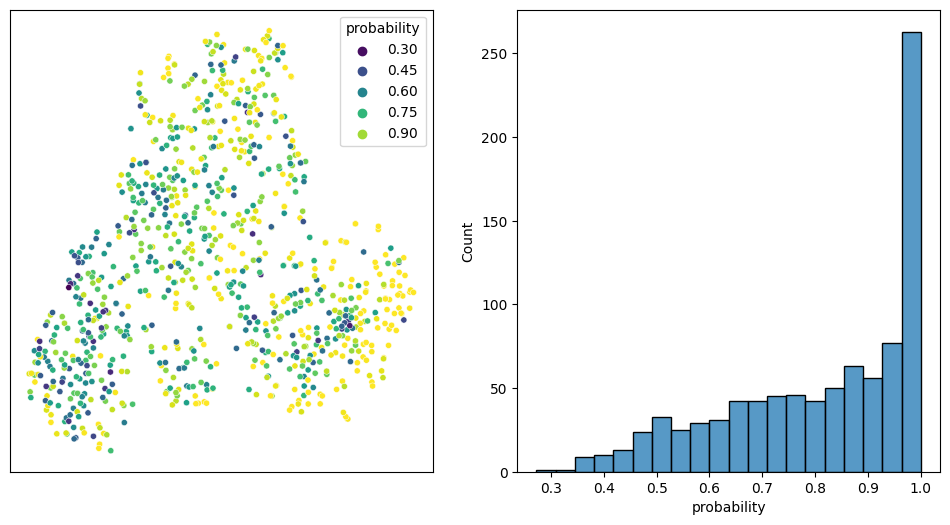

In [8]:
import matplotlib.pyplot as plt
import warnings
from seaborn import histplot
from seaborn import scatterplot

warnings.filterwarnings('ignore', category=FutureWarning, module='seaborn')

plot_df = test_df[['x', 'y']].copy()
plot_df['probability'] = np.max(logreg.predict_proba(X=test_df['value'].apply(func=pd.Series)), axis=1)

plt, ax = plt.subplots(ncols=2, figsize=(12, 6))
scatterplot(ax=ax[0], data=plot_df, x='x', y='y', hue='probability', palette='viridis', s=20)
ax[0].set(xlabel=None)
ax[0].set(ylabel=None)
ax[0].set(xticklabels=[])
ax[0].set(yticklabels=[])
ax[0].tick_params(axis='both', which='both', length=0)
histplot(ax=ax[1], data=plot_df, x='probability', bins=20)

We have some places where our model probabilities are high, but for the most part this is a hard problem.